In [1]:
from pathlib import Path
from anndata import read_h5ad

import sys
import scanpy as sc
import os
import matplotlib.pyplot as plt
import seaborn as sns

import numpy as np
import pandas as pd
from scipy.stats import nbinom, pearsonr

import tensorflow as tf
from tensorflow.keras import backend as K
from tensorflow.keras.models import load_model
# stimage custom 
file = Path("../stimage").resolve() # path to src code
parent = file.parent
sys.path.append(str(parent))

from tqdm import tqdm

from stimage._utils import gene_plot, Read10X, ReadOldST, tiling
from stimage._model import CNN_NB_multiple_genes, negative_binomial_layer, negative_binomial_loss
from stimage._data_generator import DataGenerator

import pickle
import anndata as ad
from scipy.stats import zscore

In [2]:
from scipy import stats

def plot_correlation(df, attr_1, attr_2):
    r = stats.pearsonr(df[attr_1], 
                       df[attr_2])[0] **2

    g = sns.lmplot(data=df,
        x=attr_1, y=attr_2,
        height=5, legend=True
    )
    # g.set(ylim=(0, 360), xlim=(0,360))

    g.set_axis_labels(attr_1, attr_2)
    plt.annotate(r'$R^2:{0:.2f}$'.format(r),
                (max(df[attr_1])*0.9, max(df[attr_2])*0.9))
    return g


def calculate_correlation(attr_1, attr_2):
    r = stats.pearsonr(attr_1, 
                       attr_2)[0]
    return r

def calculate_correlation_2(attr_1, attr_2):
    r = stats.spearmanr(attr_1, 
                       attr_2)[0]
    return r

In [4]:
DATA_PATH = Path("/scratch/imb/Xiao/STimage_100run/dataset_breast_cancer_9visium")
OUT_PATH = Path("/scratch/imb/Xiao/STimage/development/stimage_Pfizer_10run/results")
OUT_PATH.mkdir(parents=True, exist_ok=True)
adata_all = read_h5ad(DATA_PATH / "all_adata.h5ad")

adata_all.obs["tile_path"] = adata_all.obs.tile_path.map(
    lambda x: x.replace("/clusterdata/uqxtan9/Xiao/breast_cancer_9visium",
                        "/scratch/imb/Xiao/STimage_100run/dataset_breast_cancer_9visium"))


df_gene_ls = pd.read_csv("/scratch/imb/Xiao/STimage/development/stimage_Pfizer_10run/Intersection_marker_genes.csv", sep=",")

gene_list_select = df_gene_ls["gene_name"].values.tolist()

gene_list = adata_all.var_names.intersection(gene_list_select)

DATA_PATH = Path("/clusterdata/uqxtan9/Xiao/dataset_Pfizer")

adata_all_ = read_h5ad(DATA_PATH / "all_adata.h5ad")

adata_all = adata_all_[adata_all_.obs["library_id"].isin(
    adata_all_.obs.library_id.cat.remove_categories("block1").unique())]
samples = adata_all.obs["library_id"].unique().tolist()

In [5]:
def get_samples_stats_geneid(np_preds, list_genes, k=1):
    """
    """
    # mean and var functions of k...
    nb_mean = lambda n, p, k: n*(1-p*k)/(p*k)
    nb_var = lambda n, p, k: n*(1-p*k)/(p*p*k*k)
    
    res = []
    for gene_idx, gene_name in enumerate(list_genes):
        
        # predicted NB params 
        n, p = np_preds[gene_idx][:,0], np_preds[gene_idx][:,1]
        # mean (with p corrected by k factor)
        mu = nb_mean(n, p, k)
        # var (with p corrected by k factor)
        var = nb_var(n, p, k)
        
        res.append(np.stack([n, p, mu, var], axis=1))
        
    return np.stack(res, axis=2)

In [7]:
for sample in samples:
    adata = adata_all[adata_all.obs.library_id==sample]
    for e_id in tqdm(range(0,4)):
        
        df = pd.DataFrame()
        with open(OUT_PATH / f"ensemble_results_{sample}_{e_id}.pkl", 'rb') as file:
            test_predictions = pickle.load(file)
            
        print("Predicting Run {}:".format(e_id))
        y_preds_mean = []
        y_preds_var = []
        for i in range(len(gene_list)):
            n = test_predictions[i][:, 0]
            p = test_predictions[i][:, 1]
    #       y_pred = nbinom.mean(n, p)
            y_pred_mean, y_pred_var = nbinom.stats(n, p, moments='mv')
            y_preds_mean.append(y_pred_mean)
            y_preds_var.append(y_pred_var)
        pred_adata = adata.copy()
        pred_adata.obsm["predicted_gene_mean"] = np.array(y_preds_mean).transpose()
        pred_adata.obsm["predicted_gene_var"] = np.array(y_preds_var).transpose()
        pred_df = pd.DataFrame(pred_adata.obsm["predicted_gene_mean"], index=pred_adata.obs_names, columns=gene_list)
        pred_df.to_csv(OUT_PATH / f"prediction_df_{sample}_{e_id}.csv")
    #     adata_.X = adata_.obsm["predicted_gene_mean"]

    #     adata_.obsm["predicted_gene_var"].to_csv(OUT_PATH / "prediction_df_CFFPE_{}.csv".format(e_id))

        test_dataset = adata.copy()

        for i, gene in enumerate(gene_list):
            try:
                cor_val = calculate_correlation(pred_df.loc[:,gene], test_dataset.to_df().loc[:,gene])
                df = df.append(pd.Series([gene, cor_val, sample, e_id], index=["Gene", "Pearson correlation", "Slide", "Run"]),
                          ignore_index=True)
            except:
                continue
        df.to_csv(OUT_PATH / f"corr_df_{sample}_{e_id}.csv")

  0%|          | 0/4 [00:00<?, ?it/s]

Predicting Run 0:


 25%|██▌       | 1/4 [02:39<07:59, 159.82s/it]

Predicting Run 1:


 50%|█████     | 2/4 [05:19<05:19, 159.63s/it]

Predicting Run 2:


 75%|███████▌  | 3/4 [07:58<02:39, 159.35s/it]

Predicting Run 3:


  0%|          | 0/4 [00:00<?, ?it/s]

Predicting Run 0:


 25%|██▌       | 1/4 [02:44<08:14, 164.79s/it]

Predicting Run 1:


 50%|█████     | 2/4 [05:30<05:30, 165.20s/it]

Predicting Run 2:


 75%|███████▌  | 3/4 [08:14<02:44, 164.94s/it]

Predicting Run 3:


  0%|          | 0/4 [00:00<?, ?it/s]

Predicting Run 0:


 25%|██▌       | 1/4 [01:15<03:47, 75.77s/it]

Predicting Run 1:


 50%|█████     | 2/4 [02:32<02:32, 76.31s/it]

Predicting Run 2:


 75%|███████▌  | 3/4 [03:51<01:17, 77.36s/it]

Predicting Run 3:


  0%|          | 0/4 [00:00<?, ?it/s]

Predicting Run 0:


 25%|██▌       | 1/4 [01:51<05:35, 111.74s/it]

Predicting Run 1:


 50%|█████     | 2/4 [03:44<03:44, 112.22s/it]

Predicting Run 2:


 75%|███████▌  | 3/4 [05:37<01:52, 112.65s/it]

Predicting Run 3:


  0%|          | 0/4 [00:00<?, ?it/s]

Predicting Run 0:


 25%|██▌       | 1/4 [02:12<06:37, 132.57s/it]

Predicting Run 1:


 50%|█████     | 2/4 [04:25<04:25, 132.55s/it]

Predicting Run 2:


 75%|███████▌  | 3/4 [06:37<02:12, 132.64s/it]

Predicting Run 3:


  0%|          | 0/4 [00:00<?, ?it/s]

Predicting Run 0:


 25%|██▌       | 1/4 [02:03<06:11, 123.77s/it]

Predicting Run 1:


 50%|█████     | 2/4 [04:07<04:07, 123.74s/it]

Predicting Run 2:


 75%|███████▌  | 3/4 [06:09<02:02, 122.98s/it]

Predicting Run 3:


  0%|          | 0/4 [00:00<?, ?it/s]

Predicting Run 0:


 25%|██▌       | 1/4 [02:25<07:15, 145.04s/it]

Predicting Run 1:


 50%|█████     | 2/4 [04:51<04:51, 145.98s/it]

Predicting Run 2:


 75%|███████▌  | 3/4 [07:17<02:25, 145.94s/it]

Predicting Run 3:


  0%|          | 0/4 [00:00<?, ?it/s]

Predicting Run 0:


 25%|██▌       | 1/4 [02:33<07:39, 153.30s/it]

Predicting Run 1:


 50%|█████     | 2/4 [05:05<05:04, 152.39s/it]

Predicting Run 2:


 75%|███████▌  | 3/4 [07:38<02:33, 153.06s/it]

Predicting Run 3:


  0%|          | 0/4 [00:00<?, ?it/s]

Predicting Run 0:


 25%|██▌       | 1/4 [01:50<05:30, 110.10s/it]

Predicting Run 1:


 50%|█████     | 2/4 [03:40<03:40, 110.04s/it]

Predicting Run 2:


 75%|███████▌  | 3/4 [05:30<01:50, 110.16s/it]

Predicting Run 3:


  0%|          | 0/4 [00:00<?, ?it/s]

Predicting Run 0:


 25%|██▌       | 1/4 [01:59<05:57, 119.05s/it]

Predicting Run 1:


 50%|█████     | 2/4 [03:57<03:57, 118.68s/it]

Predicting Run 2:


 75%|███████▌  | 3/4 [05:55<01:58, 118.40s/it]

Predicting Run 3:


  0%|          | 0/4 [00:00<?, ?it/s]

Predicting Run 0:


 25%|██▌       | 1/4 [01:55<05:45, 115.24s/it]

Predicting Run 1:


 50%|█████     | 2/4 [03:48<03:47, 113.95s/it]

Predicting Run 2:


 75%|███████▌  | 3/4 [05:43<01:54, 114.65s/it]

Predicting Run 3:


100%|██████████| 4/4 [07:39<00:00, 114.82s/it]


In [8]:
predict_df_list = [OUT_PATH / f"prediction_df_{sample}_{i}.csv" for i in range(4)]

In [14]:
df_ens = pd.DataFrame()

for sample in tqdm(samples):
    adata = adata_all[adata_all.obs.library_id==sample]
    predict_df_list = [OUT_PATH / f"prediction_df_{sample}_{i}.csv" for i in range(4)]

    df_list_ens = predict_df_list
    ens_df = sum([pd.read_csv(j,index_col=0) for j in df_list_ens]) / 4
    ens_df.to_csv(OUT_PATH / f"prediction_ens_df_{sample}.csv")
    pred_adata = adata.copy()
    test_dataset = adata.copy()
    for gene in pred_adata.var_names:
        try:
            cor_val = calculate_correlation(ens_df.loc[:,gene], test_dataset.to_df().loc[:,gene])
            df_ens = df_ens.append(pd.Series([gene, cor_val, sample, 1], index=["Gene", "Pearson correlation", "Slide", "Run"]),
                      ignore_index=True)
        except:
            continue

In [15]:
df_ens.to_csv("./matrix_PFizer_4run_ens.csv")

In [16]:
top_100gene_ens = df_ens.groupby("Gene")["Pearson correlation"].mean().sort_values(ascending=False)[0:100].index
df_top_100gene_ens = df_ens[df_ens["Gene"].isin(top_100gene_ens)]

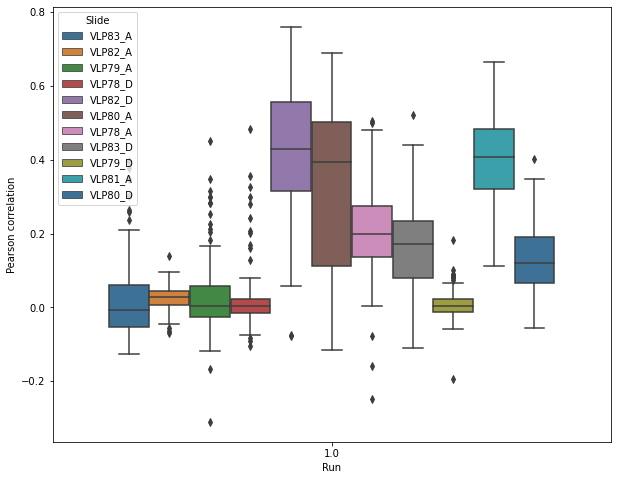

In [18]:
import seaborn as sns


fig, ax = plt.subplots(figsize=(10,8))
ax.set_xticks(range(1,13))
sns.boxplot(
    data=df_top_100gene_ens,
    x="Run", y="Pearson correlation", hue="Slide", saturation=0.6,
    ax=ax, palette="tab10"
)

# sns.lineplot(data=df_ens, x="ens_group", y="Pearson correlation", hue="Slide",
#              marker=True, size=10, ax=ax) 

plt.show()

In [21]:
luminal = ["LumB",
"LumB",
"LumB",
"LumA",
"LumA",
"LumA",
"LumA",
"LumB",
"LumA",
"LumA",
"LumB",]
vlp = [
78,
78,
79,
79,
80,
80,
81,
82,
82,
83,
83,
]
position =[
"A",
"D",
"A",
"D",
"A",
"D",
"A",
"A",
"D",
"A",
"D",
]
vlpp = [f"VLP{vlp[i]}_{position[i]}" for i in range(len(vlp))]

In [23]:
map_dic = dict(zip(vlpp, luminal))

In [24]:
map_dic

{'VLP78_A': 'LumB',
 'VLP78_D': 'LumB',
 'VLP79_A': 'LumB',
 'VLP79_D': 'LumA',
 'VLP80_A': 'LumA',
 'VLP80_D': 'LumA',
 'VLP81_A': 'LumA',
 'VLP82_A': 'LumB',
 'VLP82_D': 'LumA',
 'VLP83_A': 'LumA',
 'VLP83_D': 'LumB'}

In [26]:
df_top_100gene_ens["type"] = df_top_100gene_ens["Slide"].map(map_dic)

<ipython-input-26-9bc2eb193659>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_top_100gene_ens["type"] = df_top_100gene_ens["Slide"].map(map_dic)


In [29]:
df_ens["type"] = df_ens["Slide"].map(map_dic)

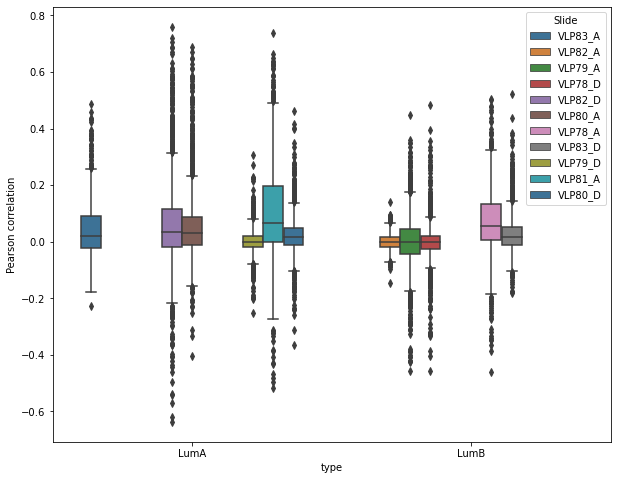

In [30]:
import seaborn as sns


fig, ax = plt.subplots(figsize=(10,8))
ax.set_xticks(range(1,13))
sns.boxplot(
    data=df_ens,
    x="type", y="Pearson correlation", hue="Slide", saturation=0.6,
    ax=ax, palette="tab10"
)

# sns.lineplot(data=df_ens, x="ens_group", y="Pearson correlation", hue="Slide",
#              marker=True, size=10, ax=ax) 

plt.show()

In [31]:
df_ens.to_csv("./matrix_PFizer_4run_ens_anno.csv")

In [38]:
top_200gene_ens = df_ens.groupby("Gene")["Pearson correlation"].mean().sort_values(ascending=False)[0:200].index

In [39]:
top_200gene_ens.values

array(['TRBC2', 'LTB', 'MS4A1', 'IKZF1', 'CD48', 'CD52', 'CD3E', 'BIRC3',
       'APP', 'CD24', 'IRF8', 'PRKCB', 'CCR7', 'ITK', 'LCK', 'TCF7',
       'CD3D', 'CD79B', 'PIK3CD', 'VEGFA', 'GIMAP7', 'MCM4', 'TRAC',
       'RAC2', 'CD53', 'CD2', 'SPOCK2', 'CCL19', 'FUBP1', 'ETS1', 'PRKDC',
       'ANXA5', 'CD69', 'POU2AF1', 'IL16', 'CCL21', 'SELL', 'CD96',
       'CD79A', 'JAK3', 'CD27', 'PTPRC', 'ZAP70', 'IL7R', 'CD28',
       'RASGRP2', 'IL2RG', 'BLK', 'CD19', 'SLAMF6', 'CD44', 'NUPR1',
       'CD9', 'LAMP1', 'LCP1', 'SOX9', 'PIK3R2', 'SH2D1A', 'CXCR4',
       'GZMK', 'MUC1', 'YAP1', 'CD7', 'A2M', 'FH', 'CTNNB1', 'CR2',
       'MGST1', 'CD37', 'CR1', 'CD6', 'CXCL13', 'PLK2', 'CD5', 'CARD11',
       'ATM', 'ANXA2', 'TIGIT', 'TNFRSF13B', 'CAPN2', 'CACNB3', 'FYB1',
       'ITGAL', 'TCF7L2', 'CD40LG', 'POLR2H', 'NFKBIZ', 'INPP5D',
       'TNFAIP3', 'CCL5', 'SOCS1', 'AKT2', 'GPI', 'VPREB3', 'AKT1',
       'EZH2', 'CXCR5', 'SDC1', 'TNFRSF12A', 'IGHM', 'COL1A2', 'PIK3AP1',
       'YTHDF2', 'IDH

In [3]:
PATH_PRED = Path("/scratch/imb/Xiao/Q1851/Xiao/Wiener_backup/STimage_exp/stimage_LOOCV_12Pfizer_selected_gene/")

In [4]:
OUT_PATH = Path("/scratch/imb/Xiao/Pfizer_gene_plot")
OUT_PATH.mkdir(parents=True, exist_ok=True)

In [5]:
gene_list = ['TRBC2', 'LTB', 'MS4A1', 'IKZF1', 'CD48', 'CD52', 'CD3E', 'BIRC3',
       'APP', 'CD24']

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


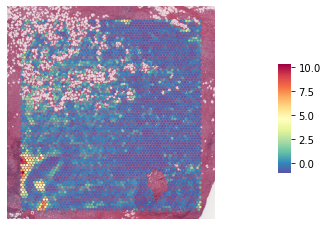

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


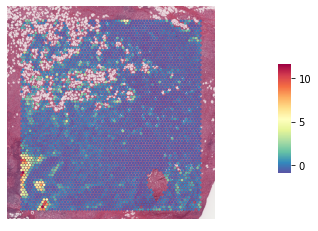

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


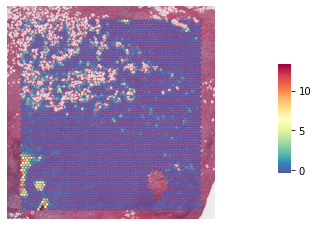

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


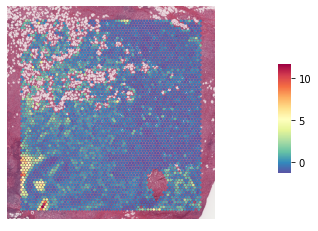

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


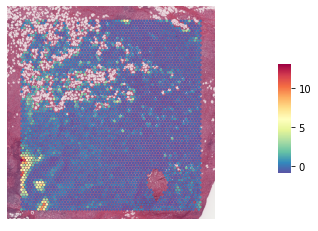

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


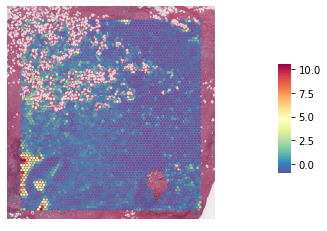

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


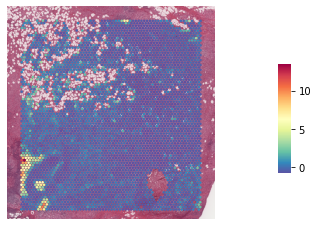

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


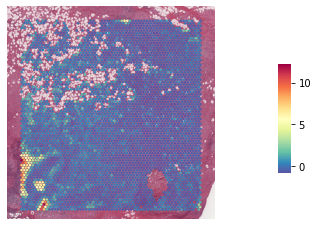

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


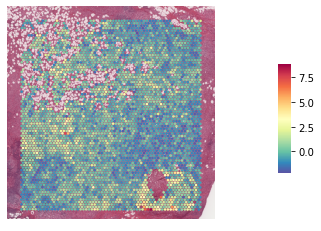

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


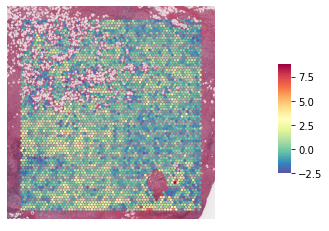

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


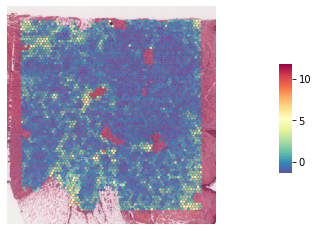

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


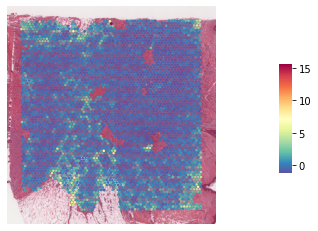

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


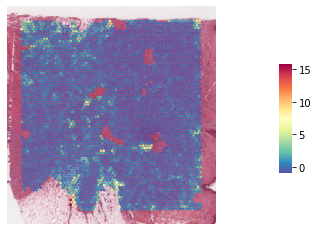

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


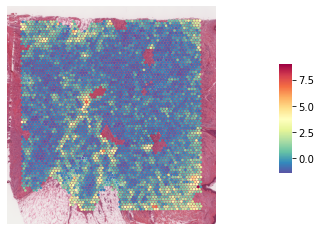

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


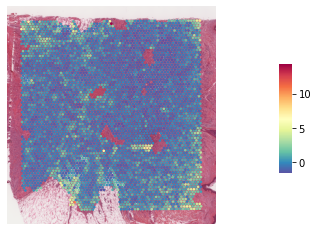

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


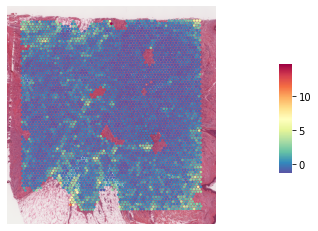

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


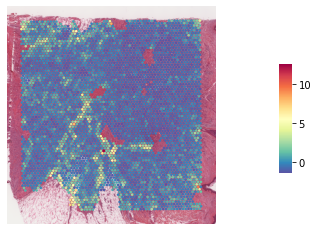

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


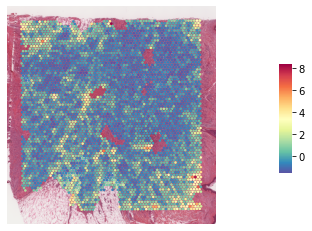

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


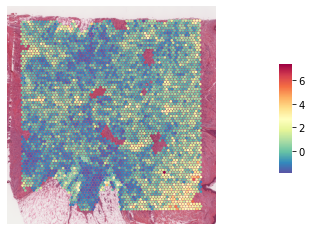

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


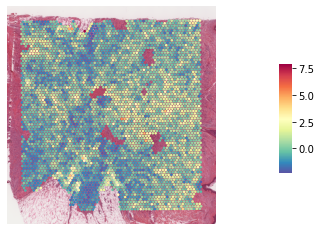

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


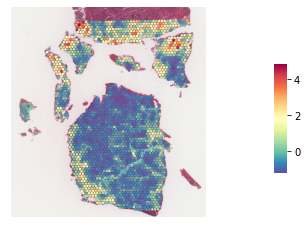

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


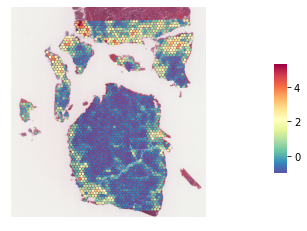

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


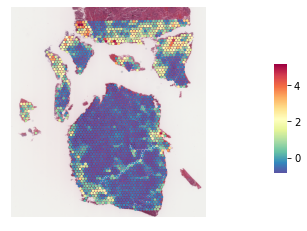

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


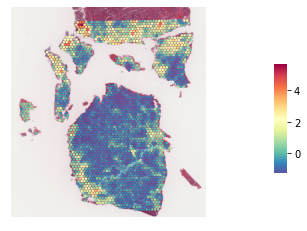

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


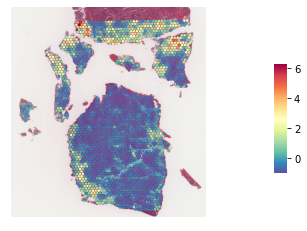

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


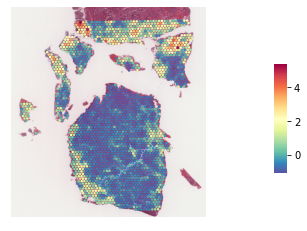

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


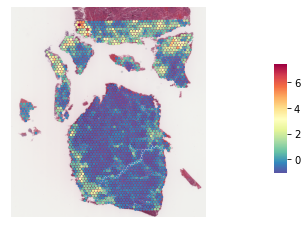

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


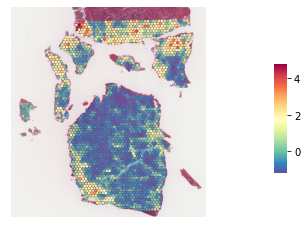

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


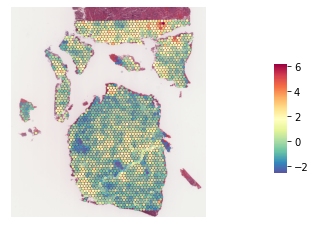

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


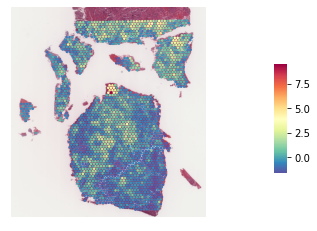

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


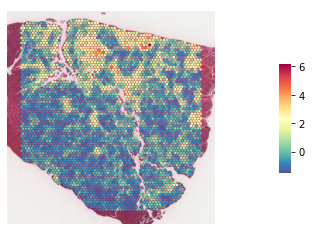

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


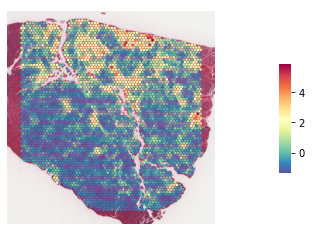

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


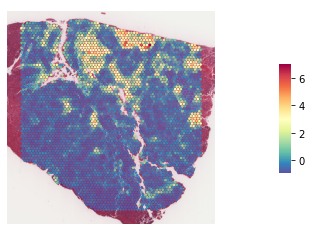

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


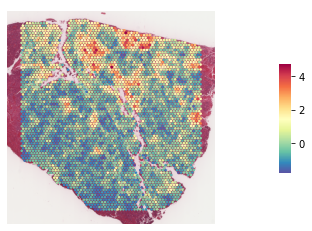

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


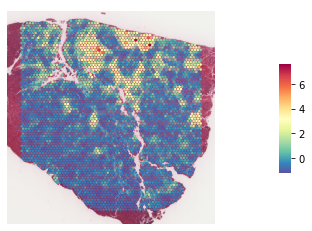

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


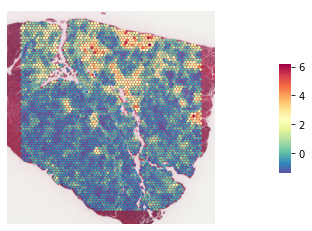

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


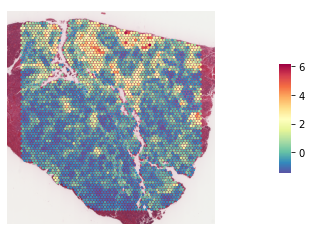

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


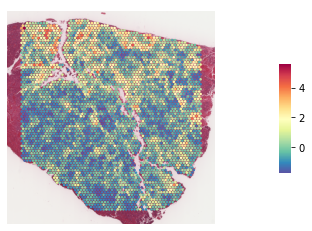

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


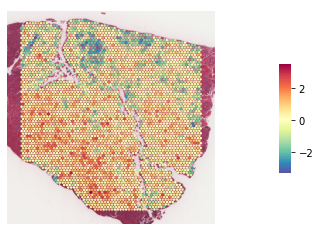

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


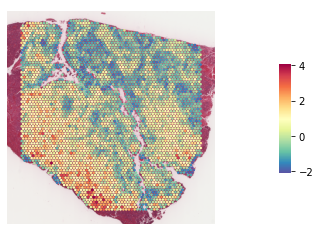

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


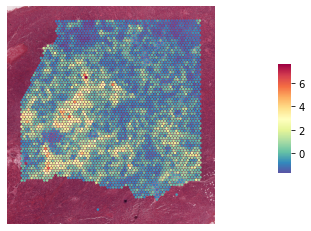

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


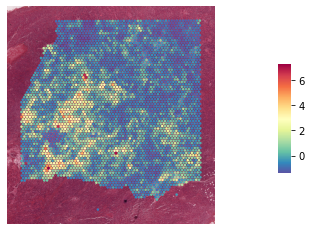

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


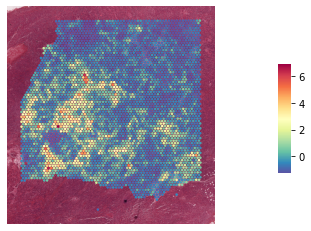

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


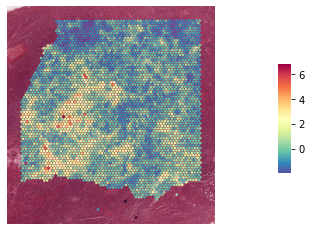

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


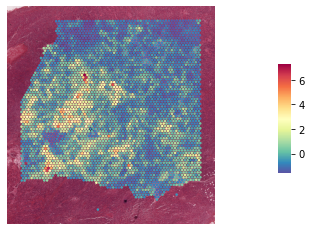

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


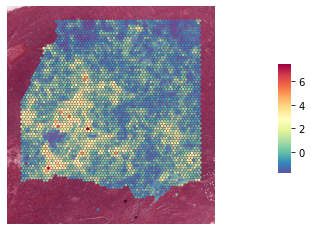

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


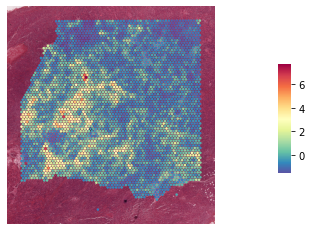

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


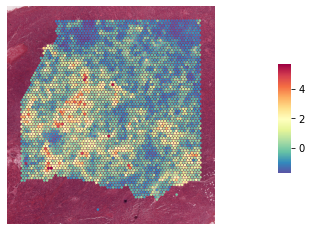

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


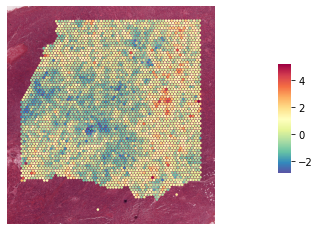

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


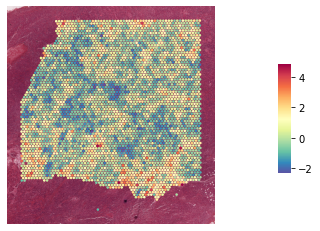

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


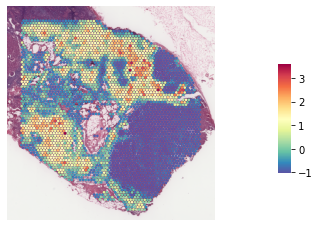

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


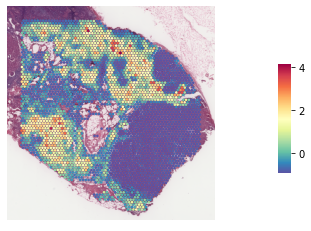

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


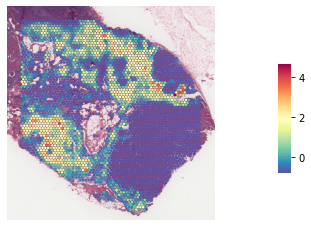

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


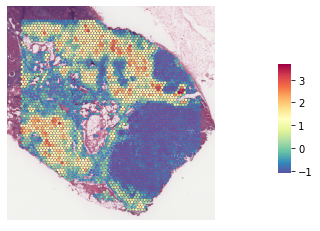

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


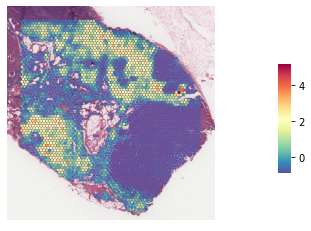

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


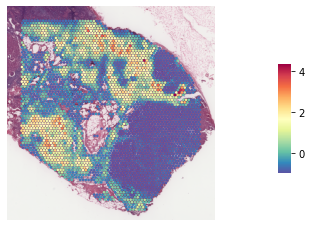

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


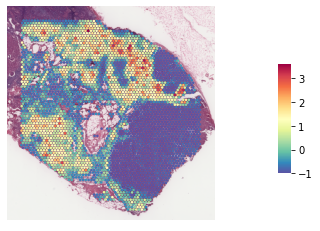

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


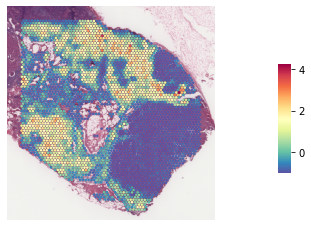

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


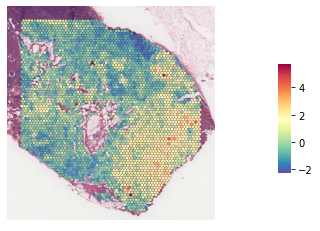

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


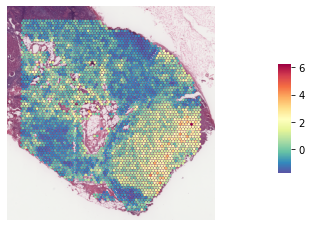

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


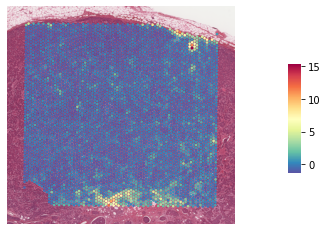

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


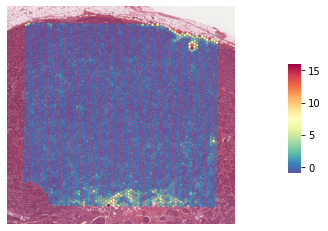

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


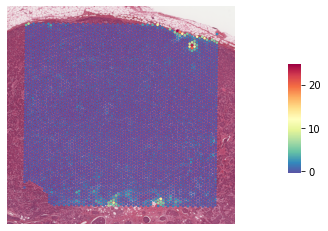

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


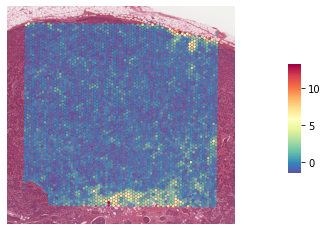

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


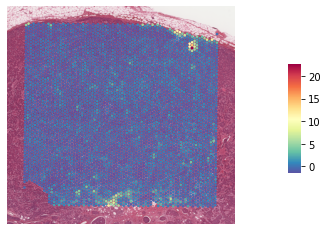

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


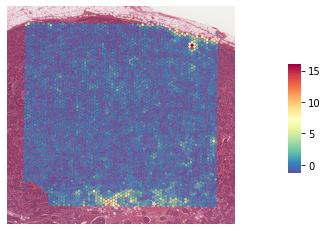

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


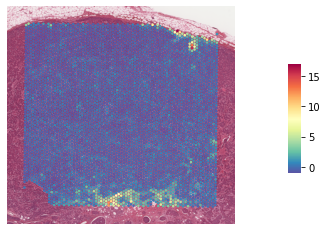

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


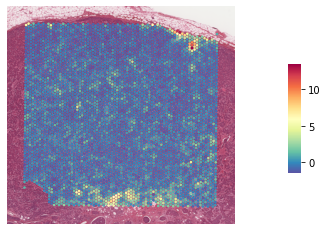

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


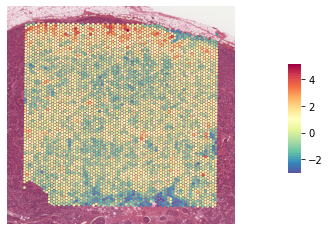

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


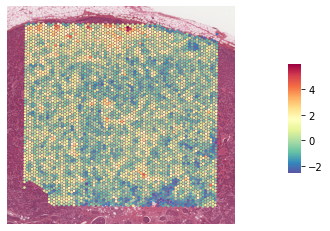

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


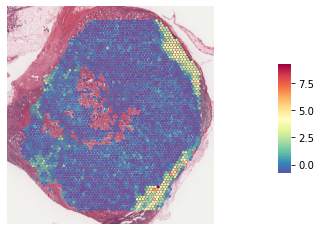

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


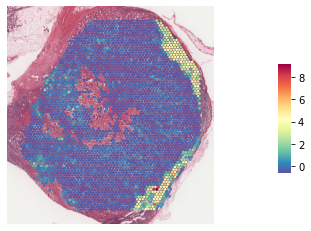

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


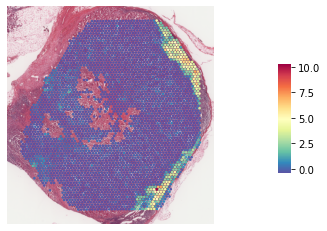

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


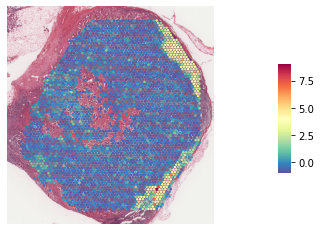

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


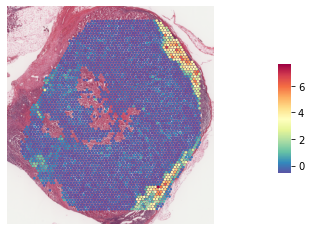

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


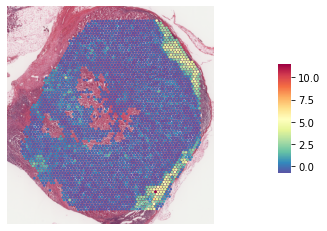

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


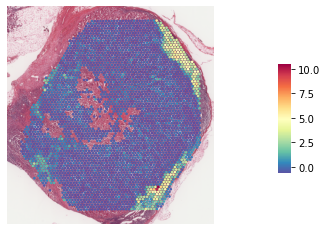

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


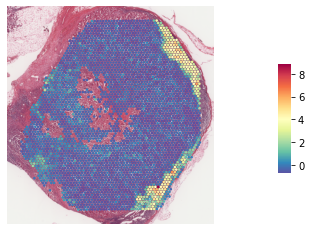

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


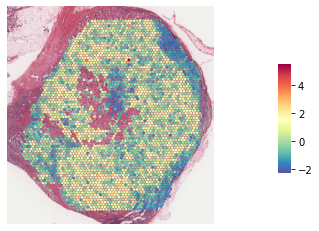

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


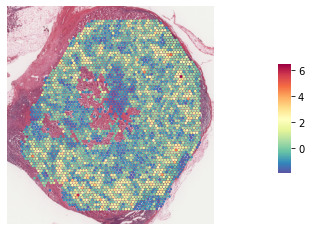

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


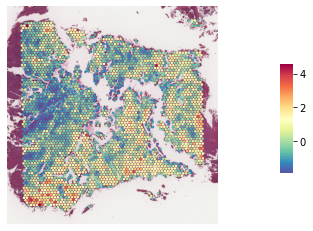

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


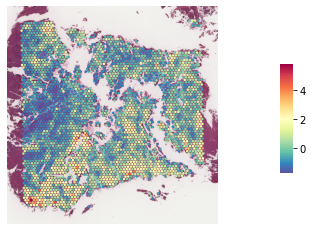

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


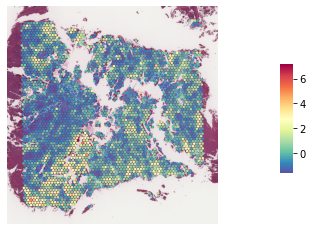

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


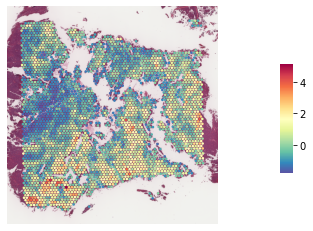

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


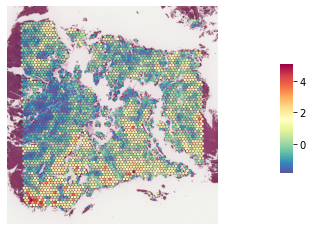

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


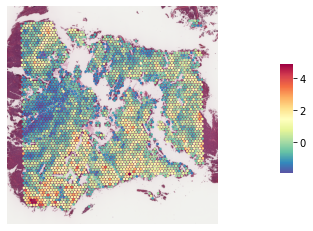

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


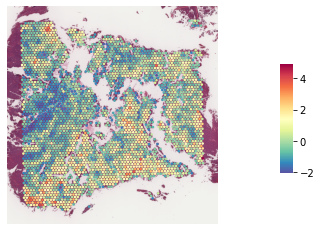

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


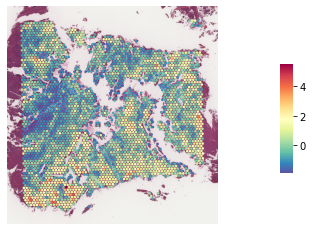

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


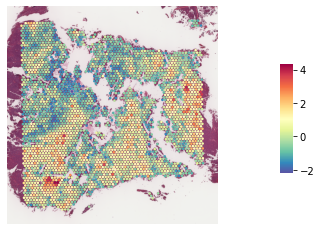

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


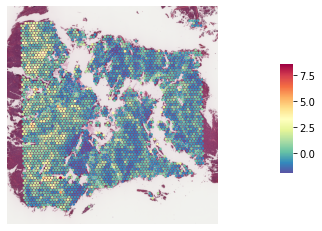

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


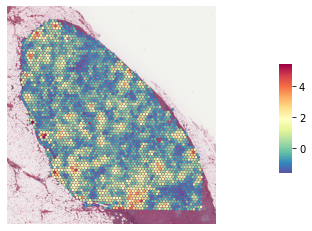

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


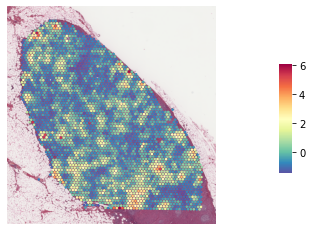

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


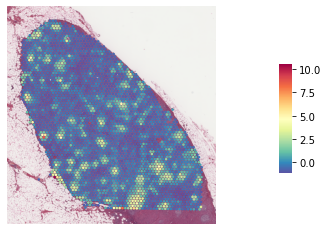

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


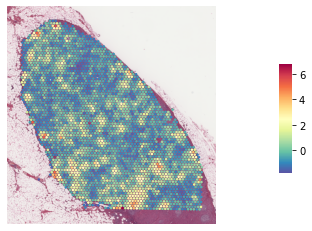

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


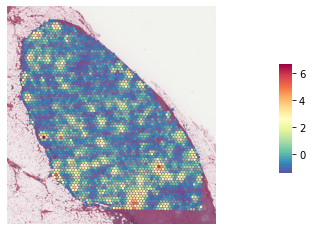

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


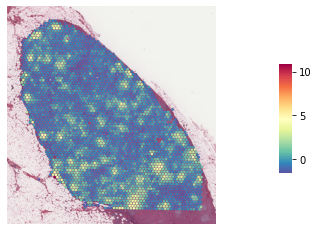

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


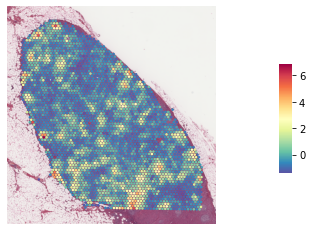

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


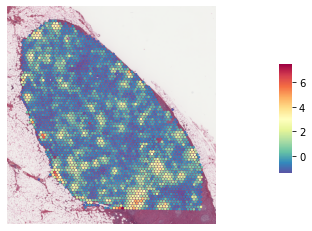

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


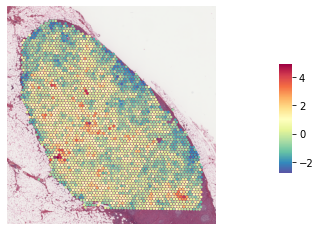

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


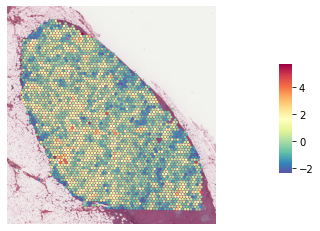

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


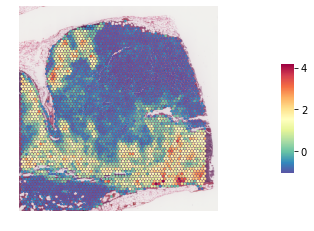

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


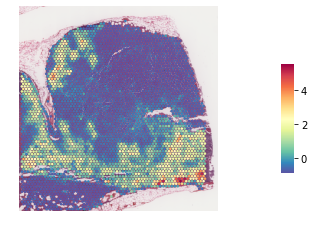

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


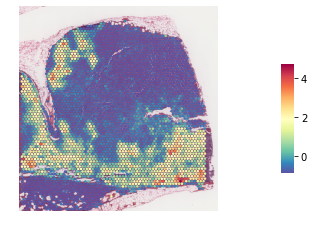

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


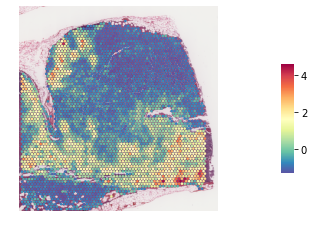

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


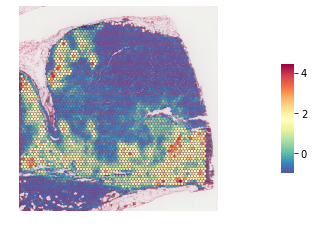

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


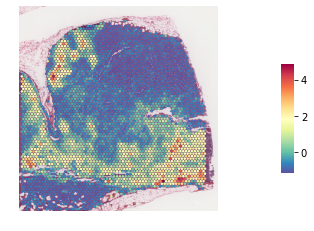

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


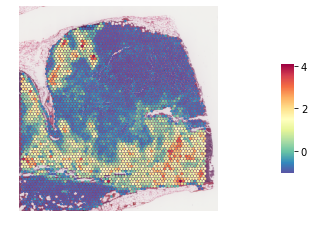

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


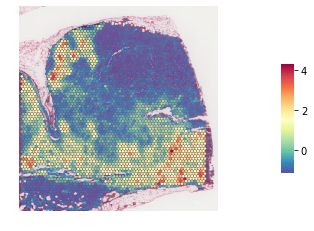

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


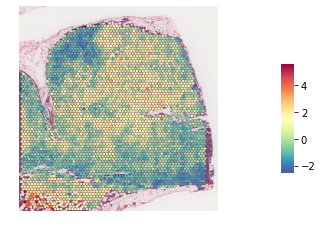

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


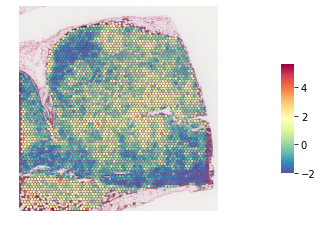

<Figure size 432x288 with 0 Axes>

In [7]:
for i in PATH_PRED.glob("./pred*"):
    sample = i.stem.split("pred_")[1]
    adata = ad.read_h5ad(i)
    adata.X = adata.to_df().apply(zscore)
    for gene in gene_list:
        try:
            gene_plot(adata, genes=gene, image_scale=10, library_id=sample, 
                     output=str(OUT_PATH), name=f"pred_{sample}_{gene}.pdf")
            plt.show()
        except:
            continue

VLP83_A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


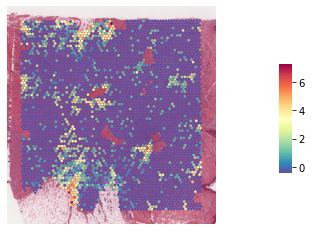

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


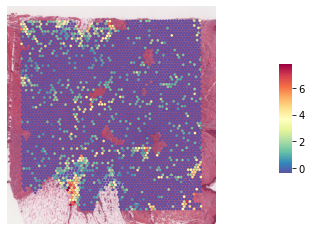

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


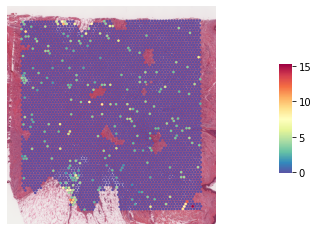

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


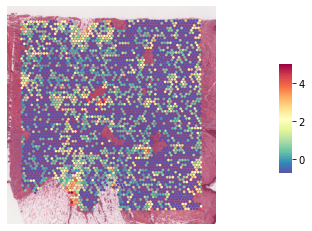

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


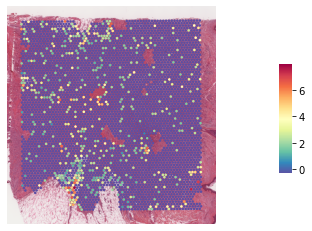

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


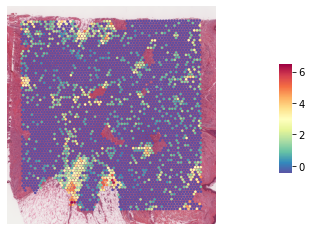

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


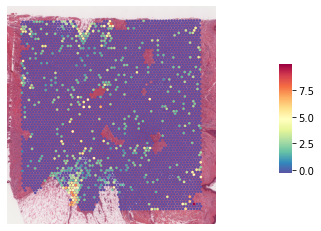

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


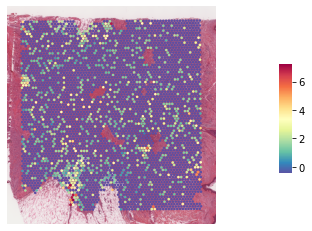

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


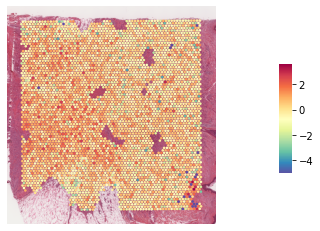

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


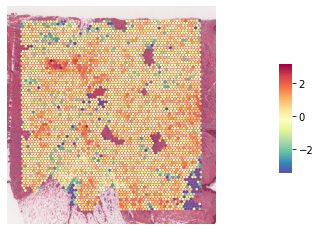

<Figure size 432x288 with 0 Axes>

VLP82_A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


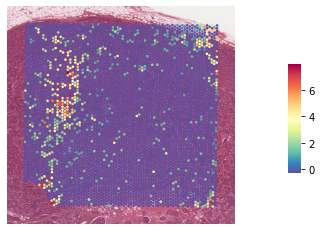

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


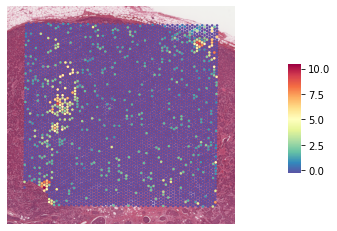

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


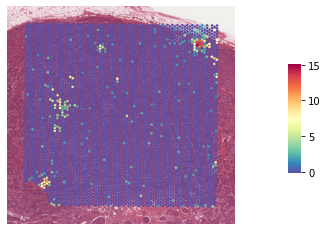

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


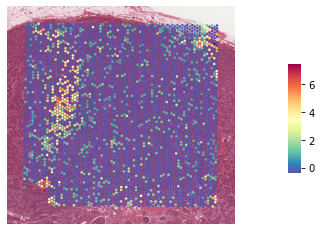

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


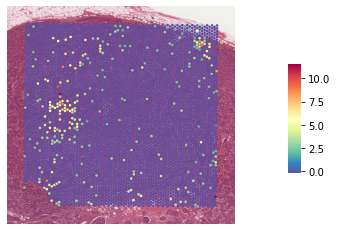

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


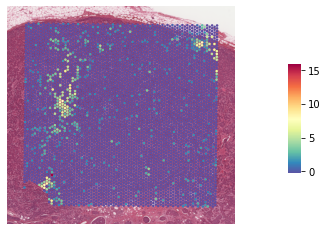

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


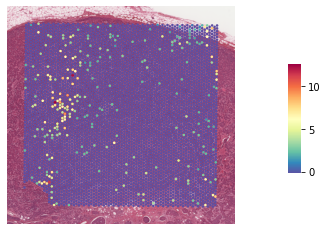

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


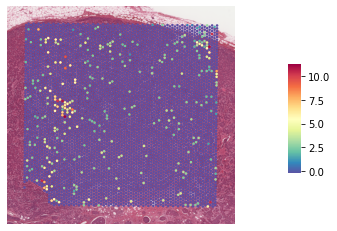

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


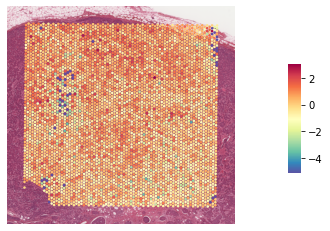

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


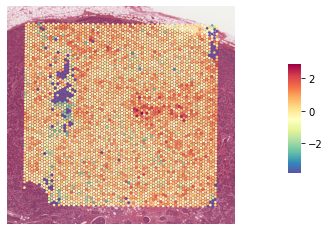

<Figure size 432x288 with 0 Axes>

VLP79_A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


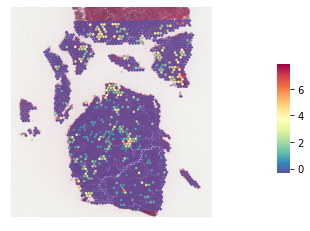

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


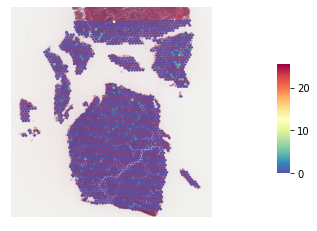

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


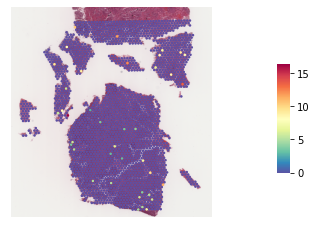

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


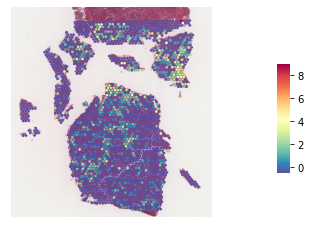

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


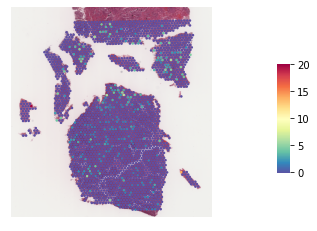

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


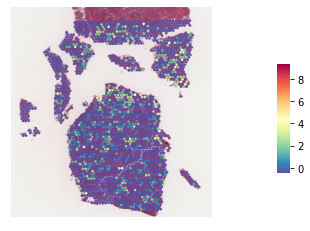

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


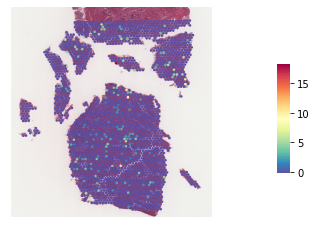

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


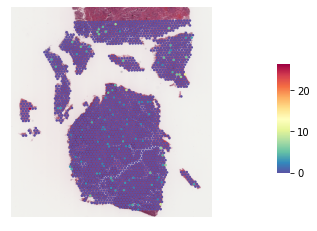

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


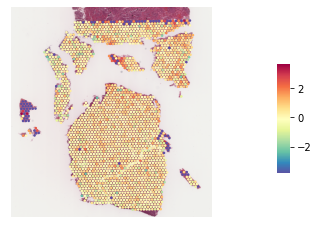

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


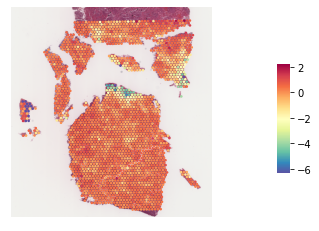

<Figure size 432x288 with 0 Axes>

VLP78_D


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


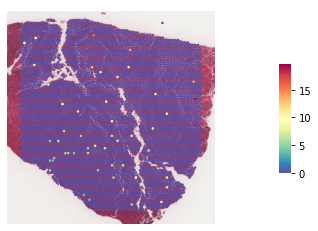

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


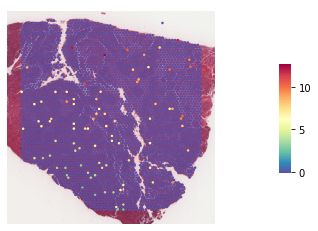

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


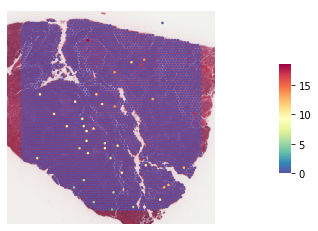

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


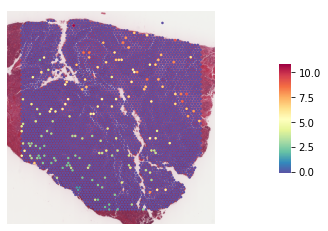

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


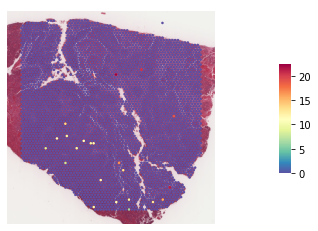

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


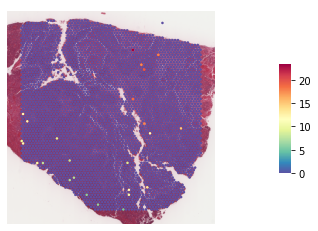

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


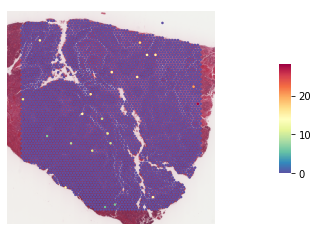

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


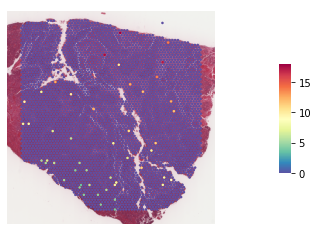

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


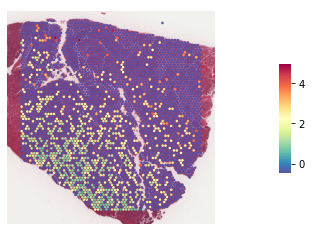

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


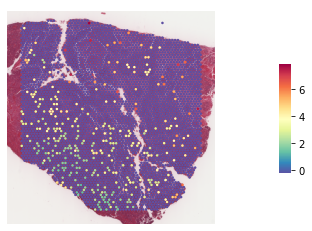

<Figure size 432x288 with 0 Axes>

VLP82_D


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


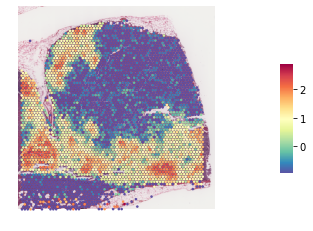

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


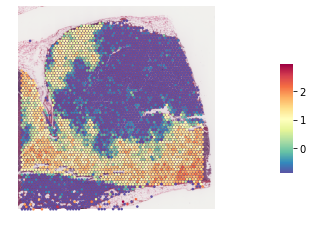

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


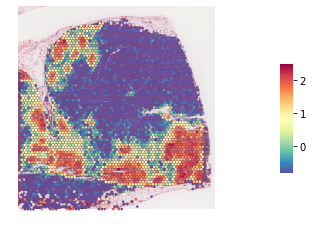

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


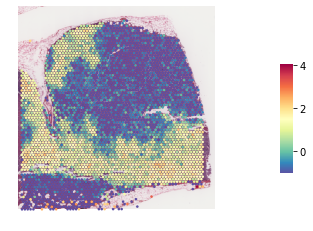

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


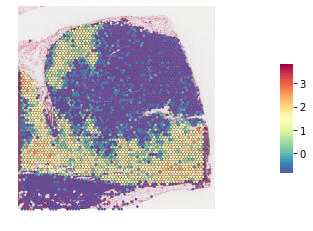

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


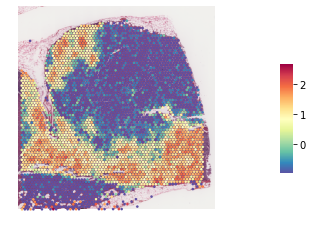

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


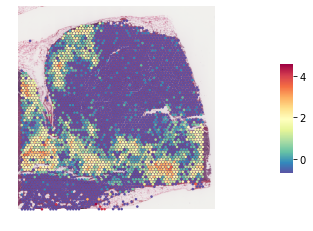

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


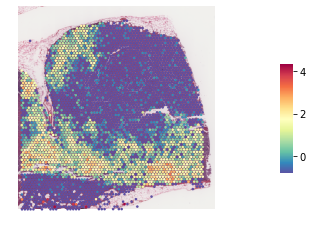

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


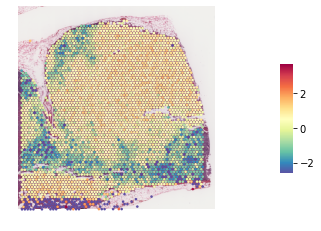

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


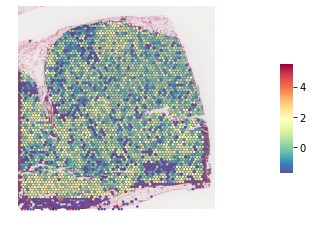

<Figure size 432x288 with 0 Axes>

VLP80_A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


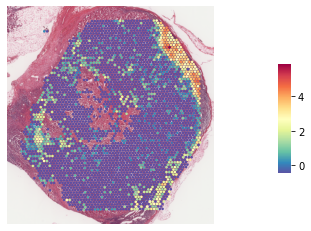

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


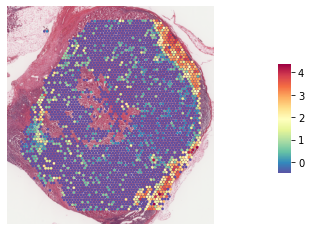

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


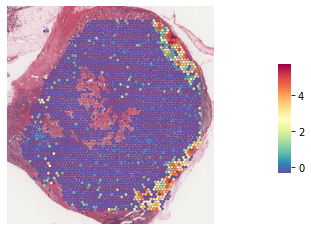

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


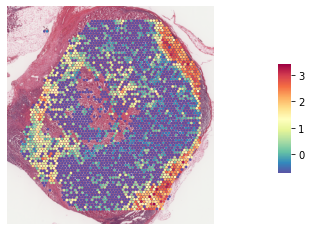

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


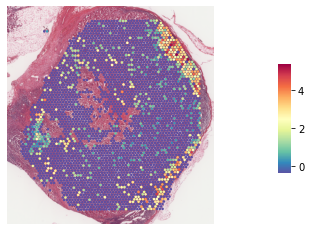

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


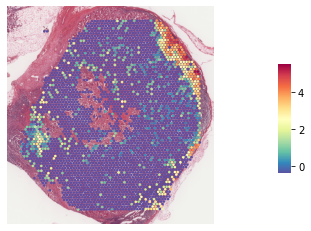

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


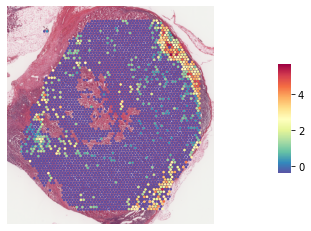

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


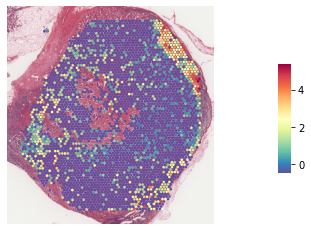

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


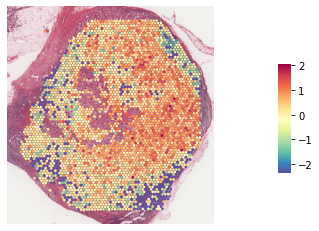

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


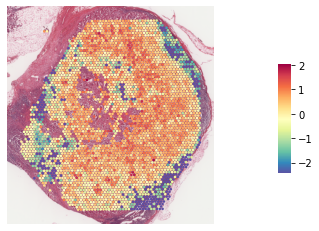

<Figure size 432x288 with 0 Axes>

VLP78_A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


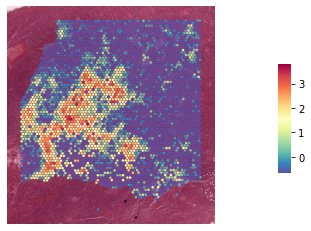

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


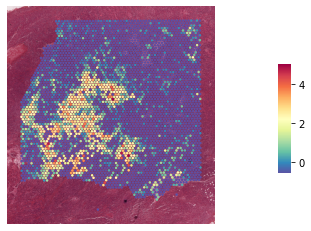

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


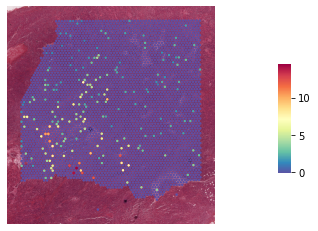

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


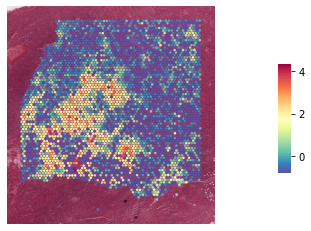

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


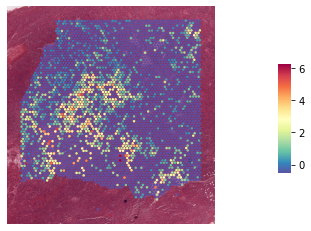

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


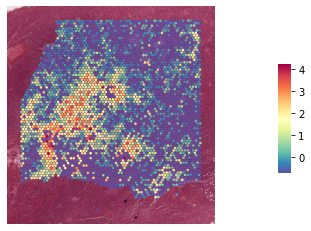

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


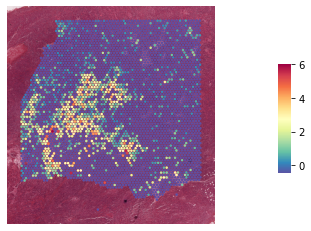

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


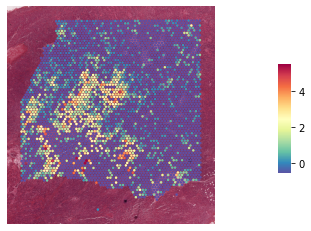

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


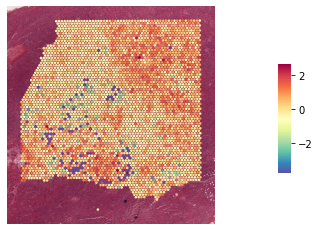

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


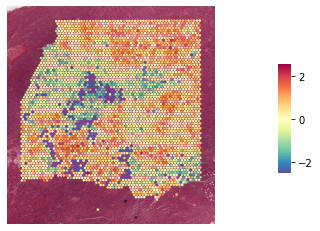

<Figure size 432x288 with 0 Axes>

VLP83_D


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


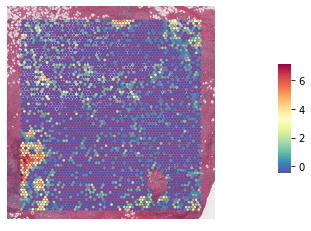

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


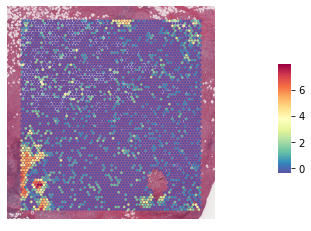

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


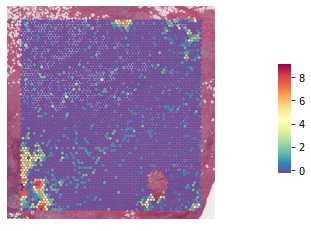

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


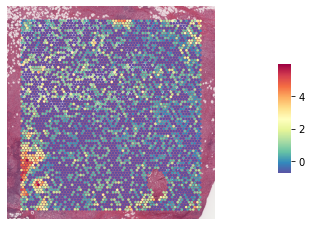

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


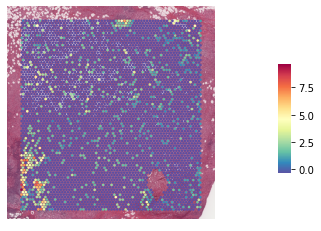

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


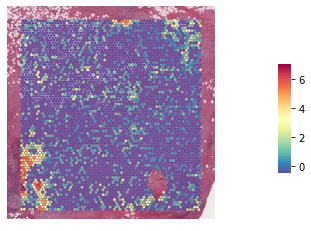

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


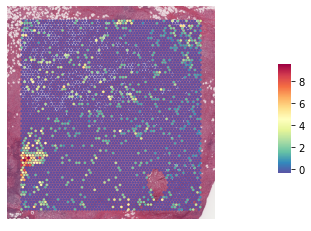

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


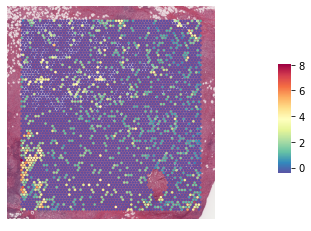

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


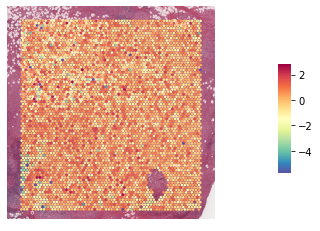

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


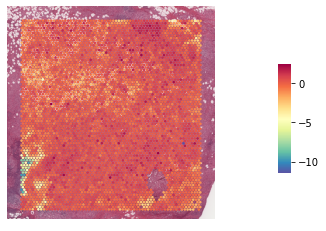

<Figure size 432x288 with 0 Axes>

VLP79_D


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


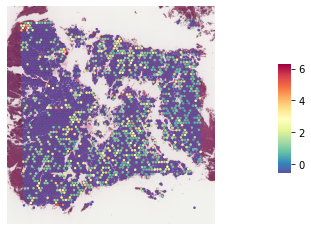

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


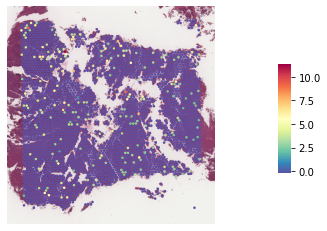

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


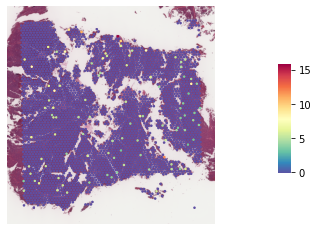

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


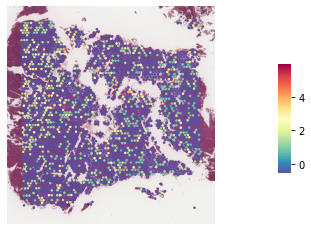

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


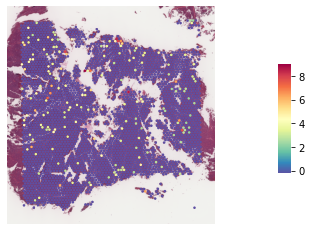

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


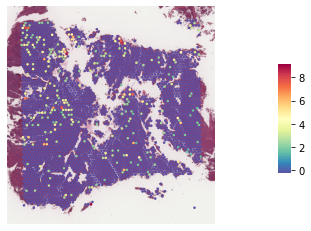

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


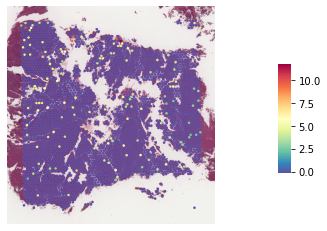

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


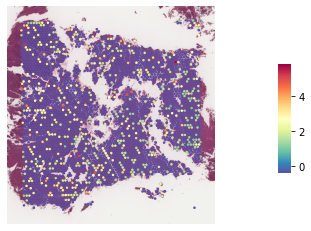

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


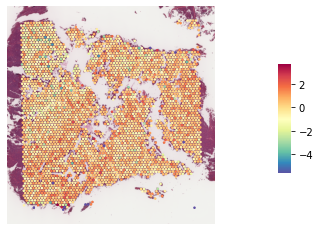

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


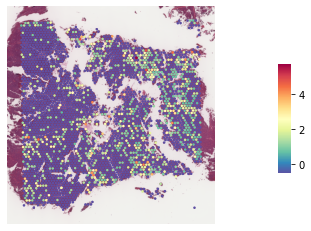

<Figure size 432x288 with 0 Axes>

VLP81_A


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


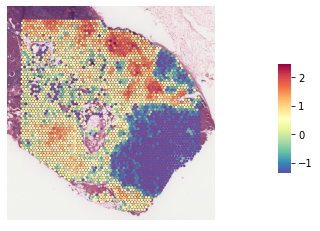

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


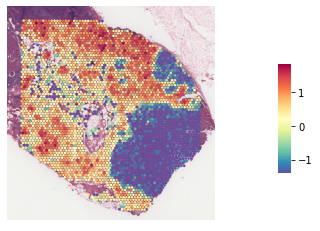

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


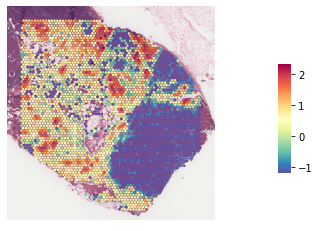

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


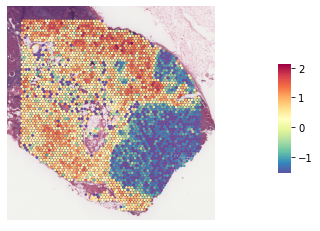

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


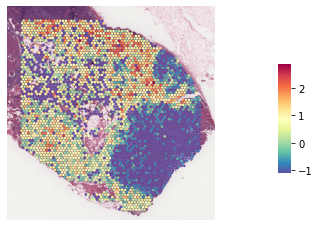

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


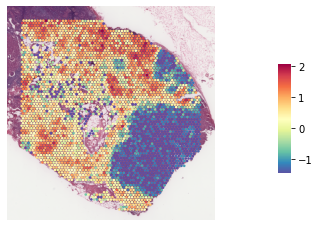

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


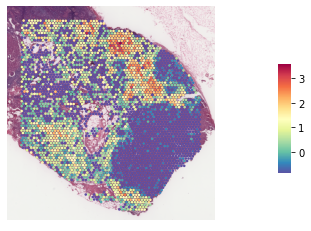

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


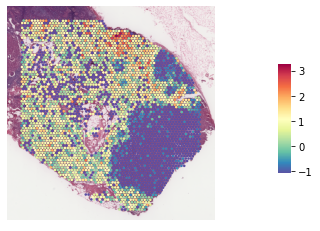

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


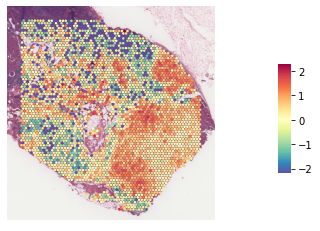

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


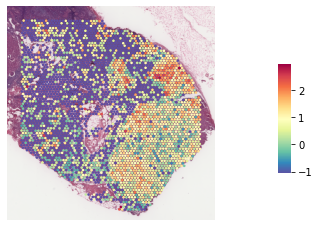

<Figure size 432x288 with 0 Axes>

VLP80_D


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


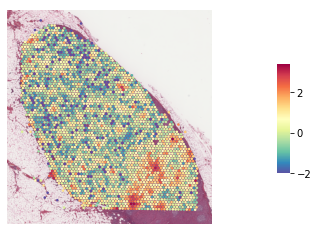

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


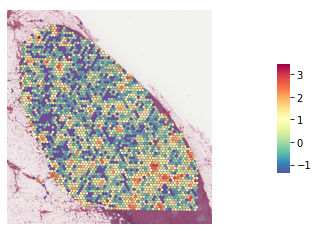

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


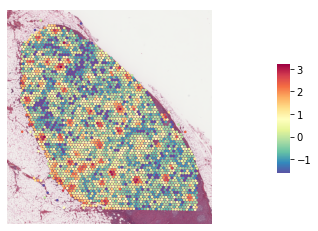

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


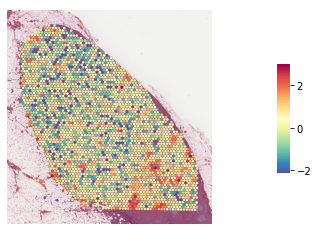

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


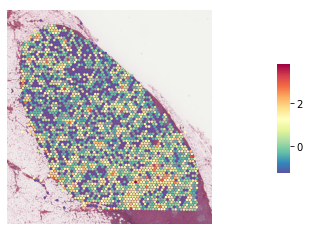

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


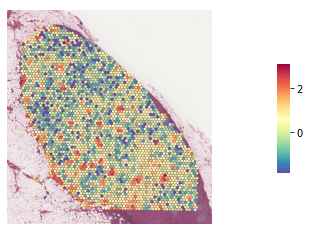

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


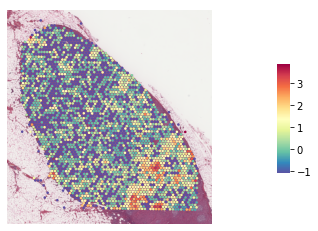

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


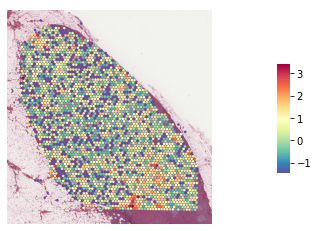

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


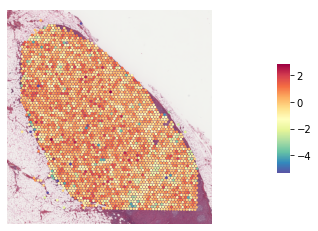

<Figure size 432x288 with 0 Axes>

/scratch/imb/Xiao/STimage/stimage/_utils.py:119: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


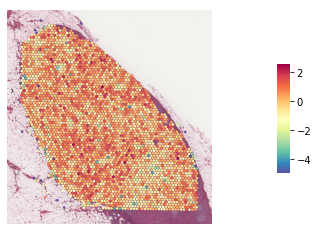

<Figure size 432x288 with 0 Axes>

In [9]:
BASE_PATH_V = Path("/clusterdata/uqxtan9/Xiao/Q2051/Pfizer/Visium_NEW")
for i in BASE_PATH_V.glob("./VLP*"):
    sample = i.stem
    print(sample)
    adata = Read10X(BASE_PATH_V / sample, quality="fulres", source_image_path=BASE_PATH_V / sample / "image.tif")
    
    sc.pp.filter_cells(adata, min_genes=1)
    sc.pp.filter_genes(adata, min_cells=1)
    sc.pp.normalize_total(adata, target_sum=1e4)
    sc.pp.log1p(adata)
    adata.X = adata.to_df().apply(zscore)
    for gene in gene_list:
        try:
            gene_plot(adata, genes=gene, image_scale=10, library_id=sample, 
                     output=str(OUT_PATH), name=f"gc_{sample}_{gene}.pdf")
            plt.show()
        except:
            continue

In [4]:
gene_list = ["BRCA1", "TP53", "KRAS", "EGFR", "MYC", "PTEN", "HER2", "BCL2", "RB1"]

In [6]:
for i in PATH_PRED.glob("./pred*"):
    sample = i.stem.split("pred_")[1]
    adata = ad.read_h5ad(i)
    adata.X = adata.to_df().apply(zscore)
    for gene in gene_list:
        try:
            gene_plot(adata, genes=gene, image_scale=10, library_id=sample, 
                     output=str(OUT_PATH), name=f"pred_{sample}_{gene}.pdf")
            plt.show()
        except:
            continue

In [8]:
# BASE_PATH_V = Path("/clusterdata/uqxtan9/Xiao/Q2051/Pfizer/Visium_NEW")
# for i in BASE_PATH_V.glob("./VLP*"):
#     sample = i.stem
#     print(sample)
#     adata = Read10X(BASE_PATH_V / sample, quality="fulres", source_image_path=BASE_PATH_V / sample / "image.tif")
    
#     sc.pp.filter_cells(adata, min_genes=1)
#     sc.pp.filter_genes(adata, min_cells=1)
#     sc.pp.normalize_total(adata, target_sum=1e4)
#     sc.pp.log1p(adata)
#     adata.X = adata.to_df().apply(zscore)
#     for gene in gene_list:
#         try:
#             gene_plot(adata, genes=gene, image_scale=10, library_id=sample, 
#                      output=str(OUT_PATH), name=f"gc_{sample}_{gene}.pdf")
#             plt.show()
#         except:
#             continue
    
    